# Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE

#from src.scripts import clustering

# Loading

In [2]:
ba_reviews = pd.read_parquet('../generated/new_ba_reviews.parquet')
rb_reviews = pd.read_parquet('../generated/new_rb_reviews.parquet')

ba_users_joined = pd.read_parquet('../generated/ba_users_joined.parquet')
rb_users_joined = pd.read_parquet('../generated/rb_users_joined.parquet')

# Data Preparation

In [3]:
ba_unique_users = ba_reviews['user_id'].unique()
ba_users_clust = ba_users_joined[ba_users_joined['user_id'].isin(ba_unique_users)].sort_values(by= 'user_id').reset_index(drop= True).copy()
ba_users_clust['platform'] = 'BeerAdvocate'

rb_unique_users = rb_reviews['user_id'].unique()
rb_users_clust = rb_users_joined[rb_users_joined['user_id'].isin(rb_unique_users)].sort_values(by= 'user_id').reset_index(drop= True).copy()
rb_users_clust['platform'] = 'RateBeer'

In [4]:
ba_groupby_users = ba_reviews.groupby('user_id')
rb_groupby_users = rb_reviews.groupby('user_id')

# Features Implementation

## 1. Average number of reviews per active time periode days

In [5]:
ba_users_clust['total_reviews'] = ba_groupby_users.agg(total_reviews= ('date', 'count')).reset_index().sort_values(by= 'user_id').total_reviews
rb_users_clust['total_reviews'] = rb_groupby_users.agg(total_reviews= ('date', 'count')).reset_index().sort_values(by= 'user_id').total_reviews

ba_first_review = ba_groupby_users['date'].min()
ba_users_clust = ba_users_clust.merge(
    ba_first_review.rename('first_review_date'), on='user_id', how='left'
    )
ba_last_review = ba_groupby_users['date'].max()
ba_users_clust = ba_users_clust.merge(
    ba_last_review.rename('last_review_date'), on='user_id', how='left'
    )
ba_users_clust['active_period'] = (ba_users_clust['last_review_date'] - ba_users_clust['first_review_date']).dt.days + 1

rb_first_review = rb_groupby_users['date'].min()
rb_users_clust = rb_users_clust.merge(
    rb_first_review.rename('first_review_date'), on='user_id', how='left'
    )
rb_last_review = rb_groupby_users['date'].max()
rb_users_clust = rb_users_clust.merge(
    rb_last_review.rename('last_review_date'), on='user_id', how='left'
    )
rb_users_clust['active_period'] = (rb_users_clust['last_review_date'] - rb_users_clust['first_review_date']).dt.days + 1

ba_users_clust['mean_daily_reviews'] = ba_users_clust['total_reviews']/ba_users_clust['active_period']
rb_users_clust['mean_daily_reviews'] = rb_users_clust['total_reviews']/rb_users_clust['active_period']

## 2. Time spacing between reviews : mean and standard deviation

In [6]:
ba_reviews_sorted = ba_reviews.sort_values(['user_id', 'date'])
# user difference between two consecutive reviews
ba_time_differences = ba_reviews_sorted.groupby('user_id')['date'].apply(lambda x : x.diff().dt.days)
# compute mean_time_spacing and standard_deviation_time_spacing
ba_users_clust[['mean_time_spacing', 'std_time_spacing']] = ba_time_differences.groupby('user_id').agg(['mean', 'std']).reset_index().sort_values(by= 'user_id')[['mean','std']]

rb_reviews_sorted = rb_reviews.sort_values(['user_id', 'date'])
# user difference between two consecutive reviews
rb_time_differences = rb_reviews_sorted.groupby('user_id')['date'].apply(lambda x : x.diff().dt.days)
# compute mean_time_spacing and standard_deviation_time_spacing
rb_users_clust[['mean_time_spacing', 'std_time_spacing']] = rb_time_differences.groupby('user_id').agg(['mean', 'std']).reset_index().sort_values(by= 'user_id')[['mean','std']]

## 3. Style diversity

In [7]:
ba_users_clust['style_diversity'] = ba_groupby_users.agg(style_diversity= ('style', 'nunique')).reset_index().sort_values(by= 'user_id').style_diversity
rb_users_clust['style_diversity'] = rb_groupby_users.agg(style_diversity= ('style', 'nunique')).reset_index().sort_values(by= 'user_id').style_diversity

## 4. Deviation between the ratings

In [8]:
ba_users_clust['ratings_std'] = ba_groupby_users.agg(ratings_std= ('rating', 'std')).reset_index().sort_values(by= 'user_id').ratings_std
rb_users_clust['ratings_std'] = rb_groupby_users.agg(ratings_std= ('rating', 'std')).reset_index().sort_values(by= 'user_id').ratings_std

In [9]:
display(ba_users_clust)
display(rb_users_clust)

,user_id,joined,platform,total_reviews,first_review_date,last_review_date,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity,ratings_std
0,--dom--.709199,2012-12-22 11:00:00,BeerAdvocate,54,2012-12-25 11:00:00,2017-03-21 11:00:00,1548,0.034884,29.132075,76.454118,18,0.310693
1,--weezl--.789708,2014-03-21 11:00:00,BeerAdvocate,3,2015-03-21 11:00:00,2015-03-21 11:00:00,1,3.000000,0.000000,0.000000,3,0.496521
2,-blast-tyrant-.1105240,2016-02-06 11:00:00,BeerAdvocate,1,2016-03-25 11:00:00,2016-03-25 11:00:00,1,1.000000,NaN,NaN,1,NaN
3,-hoptimus_prime-.960108,2015-03-17 11:00:00,BeerAdvocate,4,2015-03-17 11:00:00,2015-03-17 11:00:00,1,4.000000,0.000000,0.000000,4,1.333401
4,-liam-.930824,2015-01-21 11:00:00,BeerAdvocate,1,2015-06-22 10:00:00,2015-06-22 10:00:00,1,1.000000,NaN,NaN,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
60969,zytos.1045894,2015-09-22 10:00:00,BeerAdvocate,1,2015-10-02 10:00:00,2015-10-02 10:00:00,1,1.000000,NaN,NaN,1,NaN
60970,zyxt.993924,2015-05-31 10:00:00,BeerAdvocate,1,2015-12-20 11:00:00,2015-12-20 11:00:00,1,1.000000,NaN,NaN,1,NaN
60971,zz427.1113802,2016-02-27 11:00:00,BeerAdvocate,2,2016-02-27 11:00:00,2016-03-01 11:00:00,4,0.500000,3.000000,NaN,2,0.176777
60972,zzombie.658444,2012-02-05 11:00:00,BeerAdvocate,1,2012-12-20 11:00:00,2012-12-20 11:00:00,1,1.000000,NaN,NaN,1,NaN


,user_id,joined,platform,total_reviews,first_review_date,last_review_date,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity,ratings_std
0,10,2000-04-12 10:00:00,RateBeer,5,2000-05-26 10:00:00,2000-08-11 10:00:00,78,0.064103,19.250000,21.468970,4,1.213672
1,100007,2010-01-12 11:00:00,RateBeer,73,2010-02-27 11:00:00,2016-06-14 10:00:00,2299,0.031753,31.861111,83.476455,32,0.968770
2,100011,2010-01-12 11:00:00,RateBeer,46,2010-03-01 11:00:00,2012-02-21 11:00:00,723,0.063624,16.022222,71.223237,24,0.599581
3,100012,2010-01-12 11:00:00,RateBeer,30,2010-01-18 11:00:00,2015-01-22 11:00:00,1831,0.016384,63.103448,233.109316,20,0.756003
4,100021,2010-01-12 11:00:00,RateBeer,1,2010-01-12 11:00:00,2010-01-12 11:00:00,1,1.000000,NaN,NaN,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
70065,99974,2010-01-11 11:00:00,RateBeer,1,2010-01-11 11:00:00,2010-01-11 11:00:00,1,1.000000,NaN,NaN,1,NaN
70066,99986,2010-01-12 11:00:00,RateBeer,1,2010-01-12 11:00:00,2010-01-12 11:00:00,1,1.000000,NaN,NaN,1,NaN
70067,99992,2010-01-12 11:00:00,RateBeer,2,2010-01-12 11:00:00,2010-01-12 11:00:00,1,2.000000,0.000000,NaN,2,0.212132
70068,99994,2010-01-12 11:00:00,RateBeer,10,2010-01-12 11:00:00,2012-01-06 11:00:00,725,0.013793,80.444444,236.866582,7,0.901604


# Features Definition

The following features are used to analyze user behavior and hence identify experts on each datasets:

1. **`total_reviews`**:
   - **Definition**: The total number of reviews submitted by the user.
   - **Purpose**: Captures the level of activity or engagement of a user on the platform.

2.1 **`mean_time_spacing`**:
   - **Definition**: The average time (in days) between two consecutive reviews by the user.
   - **Purpose**: Indicates how regularly the user submits reviews. Lower values suggest more frequent activity.

2.2 **`std_time_spacing`**:
   - **Definition**: The standard deviation of the time (in days) between consecutive reviews.
   - **Purpose**: Measures the consistency of the user's review frequency. Lower values suggest more regular intervals between reviews, while higher values indicate variability.

3. **`style_diversity`**:
   - **Definition**: The total number of different styles rated by the user.
   - **Purpose**: Captures the openness of a user in addition of its activity.

4. **`ratings_std`**:
   - **Definition**: The standard deviation of the ratings submitted by the user.
   - **Purpose**: Captures ...

These features help characterize user activity and behavior over time, enabling clustering or further analysis of user patterns.


In [10]:
ba_features = ba_users_clust[['mean_daily_reviews', 'mean_time_spacing', 'std_time_spacing', 'style_diversity']]
rb_features = rb_users_clust[['mean_daily_reviews', 'mean_time_spacing', 'std_time_spacing', 'style_diversity']]

In [11]:
list_to_drop = ['joined', 'first_review_date', 'last_review_date', 'ratings_std']

concat_features = pd.concat([ba_users_clust, rb_users_clust]).dropna().drop(list_to_drop, axis= 1).set_index(['user_id', 'platform'])
ba_features = ba_users_clust.dropna().drop(columns=list_to_drop).drop(columns='platform').set_index('user_id').copy() 
rb_features = rb_users_clust.dropna().drop(columns=list_to_drop).drop(columns='platform').set_index('user_id').copy()

What .dropna() implies: It removes users with 1 review (no time_spacing) and 2 reviews (no std_time_spacing)

In [12]:
nan_counts = ba_features.isna().sum()
print(f"NaN values in BeerAdvocate features : \n{nan_counts}\n")
nan_counts = rb_features.isna().sum()
print(f"NaN values in RateBeer features : \n{nan_counts}\n")

NaN values in BeerAdvocate features : 
total_reviews         0
active_period         0
mean_daily_reviews    0
mean_time_spacing     0
std_time_spacing      0
style_diversity       0
dtype: int64

NaN values in RateBeer features : 
total_reviews         0
active_period         0
mean_daily_reviews    0
mean_time_spacing     0
std_time_spacing      0
style_diversity       0
dtype: int64



Everything seems good to start clustering.

In [13]:
display(ba_features)
display(rb_features)
display(concat_features)

,total_reviews,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity
user_id,,,,,,
--dom--.709199,54,1548,0.034884,29.132075,76.454118,18
--weezl--.789708,3,1,3.000000,0.000000,0.000000,3
-hoptimus_prime-.960108,4,1,4.000000,0.000000,0.000000,4
-mk-.763762,8,815,0.009816,116.142857,246.647811,7
-rick.912339,197,915,0.215301,4.653061,12.024848,34
...,...,...,...,...,...,...
zymurgist12.1048285,9,2,4.500000,0.125000,0.353553,2
zymurgo.447590,5,65,0.076923,16.000000,20.215506,4
zymurgy4all.11427,101,3324,0.030385,33.190000,158.064920,46


,total_reviews,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity
user_id,,,,,,
10,5,78,0.064103,19.250000,21.468970,4
100007,73,2299,0.031753,31.861111,83.476455,32
100011,46,723,0.063624,16.022222,71.223237,24
100012,30,1831,0.016384,63.103448,233.109316,20
100022,7,1,7.000000,0.000000,0.000000,6
...,...,...,...,...,...,...
99936,8,448,0.017857,63.857143,134.214292,8
99959,93,412,0.225728,4.456522,8.879428,37
99970,6,34,0.176471,6.600000,5.079370,5


,,total_reviews,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity
user_id,platform,,,,,,
--dom--.709199,BeerAdvocate,54,1548,0.034884,29.132075,76.454118,18
--weezl--.789708,BeerAdvocate,3,1,3.000000,0.000000,0.000000,3
-hoptimus_prime-.960108,BeerAdvocate,4,1,4.000000,0.000000,0.000000,4
-mk-.763762,BeerAdvocate,8,815,0.009816,116.142857,246.647811,7
-rick.912339,BeerAdvocate,197,915,0.215301,4.653061,12.024848,34
...,...,...,...,...,...,...,...
99936,RateBeer,8,448,0.017857,63.857143,134.214292,8
99959,RateBeer,93,412,0.225728,4.456522,8.879428,37
99970,RateBeer,6,34,0.176471,6.600000,5.079370,5


# Francois

total_reviews
active_period
mean_daily_reviews
mean_time_spacing
std_time_spacing
style_diversity


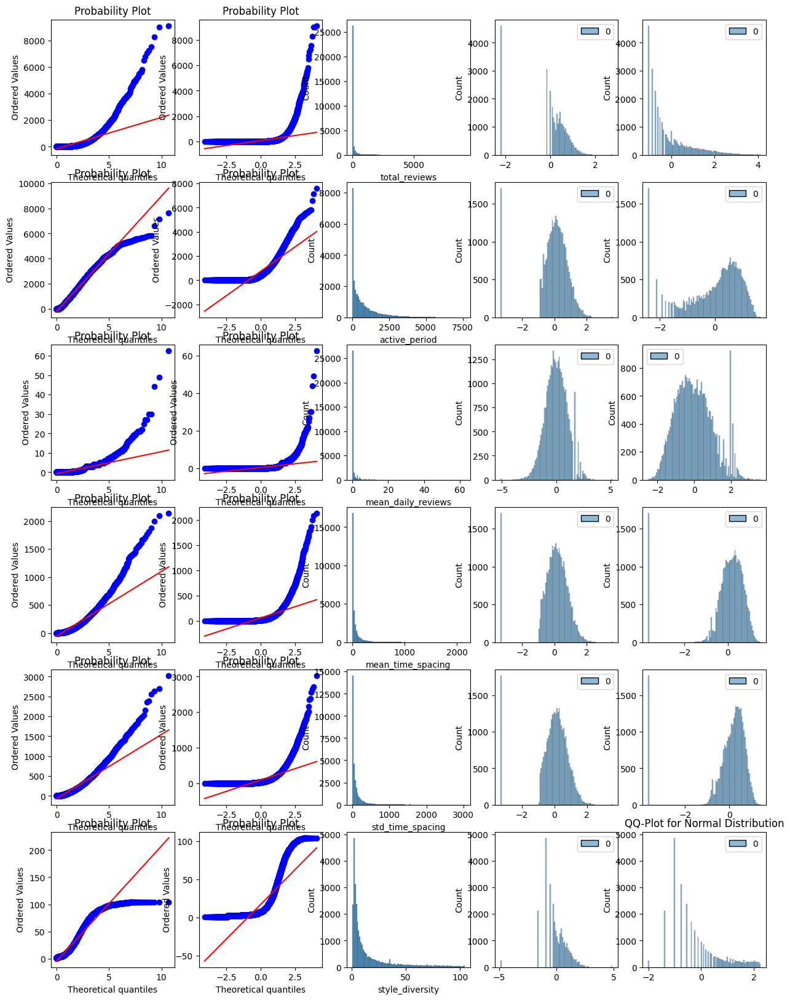

In [80]:
import scipy.stats as stats
from scipy.stats import kstest
import seaborn as sns
from sklearn.preprocessing import QuantileTransformer

# Transformation pour une distribution gaussienne
quantile_transformer = QuantileTransformer(output_distribution='normal')

fig, ax = plt.subplots(6,5,figsize=(15,20))

for i, col in enumerate(ba_features.columns):
    print(col)
    stats.probplot(ba_features[col], dist="expon", plot=ax[i][0])
    plt.title("QQ-Plot for Exponential Distribution")
    
    # QQ-Plot pour la normale
    stats.probplot(ba_features[col], dist="norm", plot=ax[i][1])
    plt.title("QQ-Plot for Normal Distribution")

    sns.histplot(ba_features[col],bins=100, ax=ax[i][2])

    sns.histplot(StandardScaler().fit_transform(np.log(1e-5+ba_features[[col]])), bins=100, ax=ax[i][4])

    sns.histplot(StandardScaler().fit_transform(
        quantile_transformer.fit_transform(ba_features[[col]])
    ), bins=100, ax=ax[i][3])


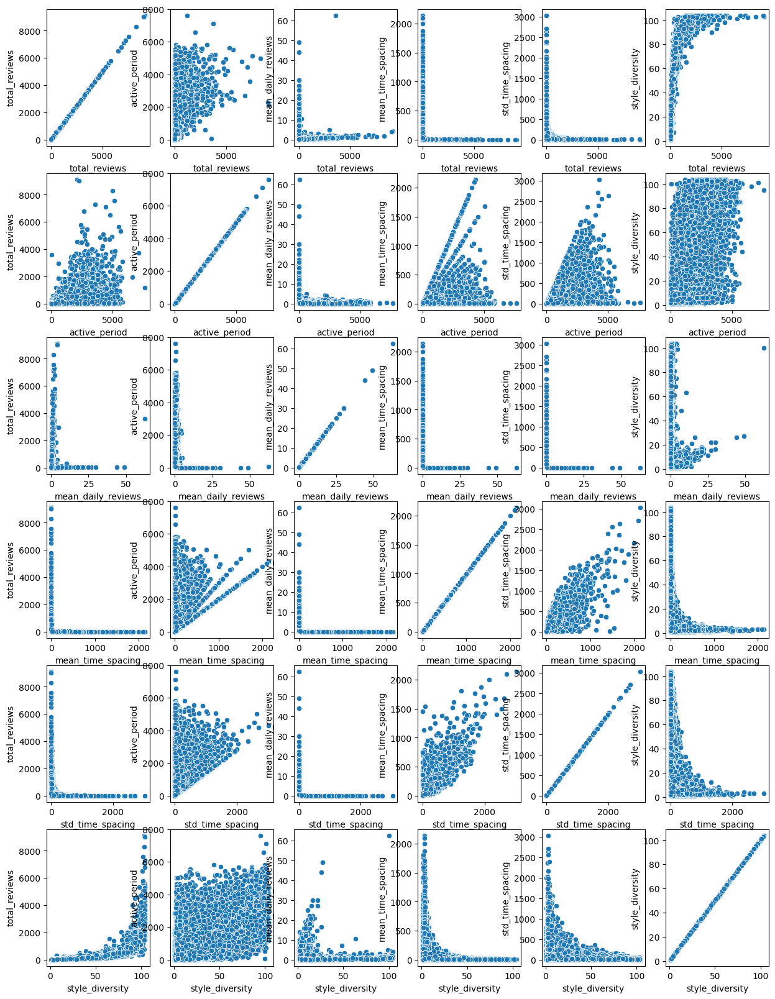

In [94]:
fig, ax = plt.subplots(6,6,figsize=(15,20))

for i, col1 in enumerate(ba_features.columns):
    for j, col2 in enumerate(ba_features.columns):
        sns.scatterplot(x=ba_features[col1], y=ba_features[col2],ax= ax[i][j])

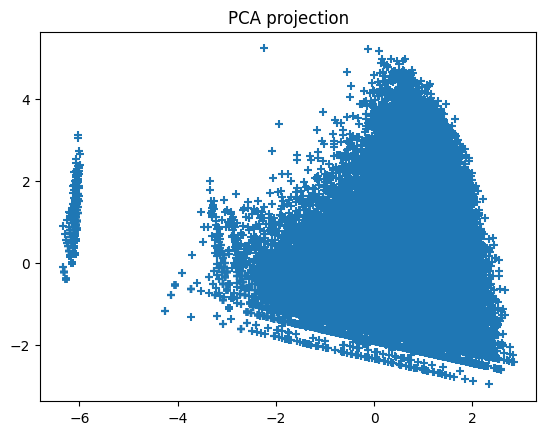

In [98]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
data_pca = pca.fit_transform(StandardScaler().fit_transform(np.log(1e-5+ba_features)))

plt.scatter(data_pca[:, 0], data_pca[:, 1], marker='+')
plt.title("PCA projection")
plt.show()

# Clustering

The clustering is made on each dataset separately, as we want to analyze the group of reviewers of the plateform that is defined as more experienced. 

We could also have done one single clustering to determine which plateform has more experienced users. 

## On BeerAdvocate

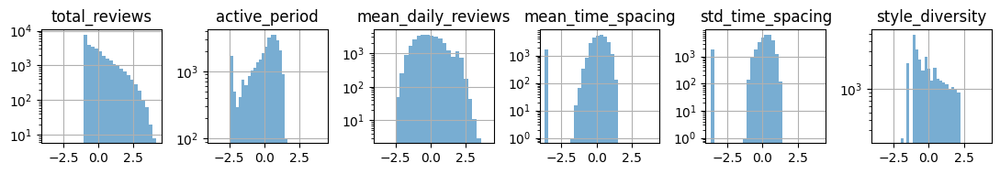

In [99]:
# ba_df_features = pd.DataFrame(quantile_transformer.fit_transform(ba_features), columns=ba_features.columns)
ba_df_features = np.log(1e-5+ba_features)
ba_df_features_scaled = pd.DataFrame(StandardScaler().fit(ba_df_features).transform(ba_df_features), columns= ba_df_features.columns)
columns = ba_df_features_scaled.columns

fig, axs = plt.subplots(1, len(columns), figsize=(11, 2), sharex=True)

for column_idx in range(0, len(columns)):
    ba_df_features_scaled[columns[column_idx]].hist(bins=20, ax=axs[column_idx], alpha=0.6)
    axs[column_idx].set_title(columns[column_idx])
    axs[column_idx].set_yscale('log') 
    
plt.tight_layout()

### Number of clusters (silhouette score + elbow method)

In [100]:
def plot_clustering_metrics(features_X, start=2, end=11):
    # Elbow Method
    sse = []
    for k in range(start, end):
        kmeans = KMeans(n_clusters=k, random_state=10).fit(features_X)
        sse.append({"k": k, "sse": kmeans.inertia_})

    sse = pd.DataFrame(sse)

    # Silhouette Score
    silhouettes = []
    for k in range(start, end):
        labels = KMeans(n_clusters=k, random_state=10).fit_predict(features_X)
        score = silhouette_score(features_X, labels)
        silhouettes.append({"k": k, "score": score})
        print(f"Implementation with k={k} done")

    silhouettes = pd.DataFrame(silhouettes)

    # Create subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))

    # Plot Elbow Method
    axes[0].plot(sse.k, sse.sse, marker='o')
    axes[0].set_xlabel("K")
    axes[0].set_ylabel("Sum of Squared Errors")
    axes[0].set_title("Elbow Method")

    # Plot Silhouette Score
    axes[1].plot(silhouettes.k, silhouettes.score, marker='o')
    axes[1].set_xlabel("K")
    axes[1].set_ylabel("Silhouette Score")
    axes[1].set_title("Silhouette Score Method")

    # Adjust layout
    plt.tight_layout()
    plt.show()

Implementation with k=2 done
Implementation with k=3 done
Implementation with k=4 done
Implementation with k=5 done
Implementation with k=6 done
Implementation with k=7 done
Implementation with k=8 done
Implementation with k=9 done
Implementation with k=10 done


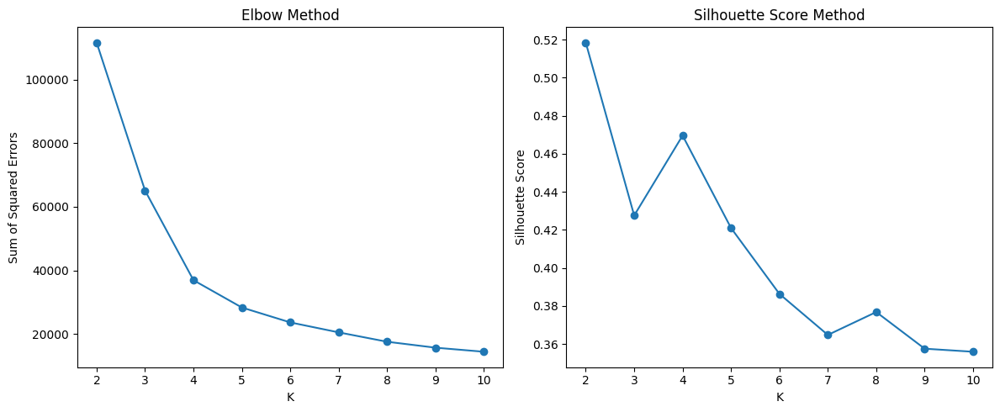

In [101]:
# Call the function with your features
plot_clustering_metrics(ba_df_features_scaled)

**Analyze:** There is no clear elbow, thus we can assume there is no real separation into different groups. This behavior was expected as the individual number of reviews (for each reviewers) follows a exponential distribution. The goal of the clustering for this case is to divide the reviewers to find a group which can be considered as experimented (high number of reviews, short reviews intervals,...).

### Predicting

In [102]:
ba_number_clusters = 3 #to determine

ba_kmeans = KMeans(n_clusters= ba_number_clusters, random_state= 0)
ba_labels = ba_kmeans.fit_predict(ba_df_features_scaled)
ba_clusterised = pd.DataFrame(pd.Series(ba_labels, index= ba_df_features.index, name= 'cluster')).reset_index()

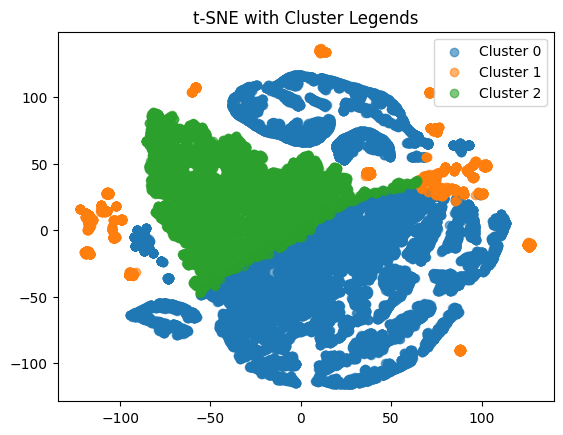

In [103]:
# perform t-SNE dimensionality reduction
ba_df_scaled_features_reduced_tsne = TSNE(n_components= 2, init= 'random', learning_rate= 'auto', random_state= 0).fit_transform(ba_df_features_scaled)
for cluster in range(ba_number_clusters):
    cluster_points = ba_df_scaled_features_reduced_tsne[ba_labels == cluster]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=f'Cluster {cluster}', alpha=0.6)
plt.title("t-SNE with Cluster Legends")
plt.legend()
plt.show()

In [104]:
ba_clusterised_feat = ba_clusterised.join(ba_features, on='user_id', how='left')

In [105]:
fig = px.scatter(ba_clusterised_feat, x='active_period', y='total_reviews', color='cluster')
fig.show()

fig = px.scatter(ba_clusterised_feat, x='total_reviews', y='mean_time_spacing', color='cluster')
fig.show()

fig = px.scatter(ba_clusterised_feat, x='mean_daily_reviews', y='mean_time_spacing', color='cluster')
fig.show()

fig = px.scatter(ba_clusterised_feat[ba_clusterised_feat['cluster']==2], x='mean_daily_reviews', y='mean_time_spacing', color='cluster')
fig.show()

fig = px.scatter(ba_clusterised_feat, x='mean_daily_reviews', y='style_diversity', color='cluster')
fig.show()

fig = px.scatter(ba_clusterised_feat, x='mean_time_spacing', y='std_time_spacing', color='cluster')
fig.show()

In [106]:
cluster_mean = ba_clusterised_feat.drop(columns='user_id').groupby('cluster').mean()
experienced_cluster = cluster_mean['total_reviews'].idxmax()
print(experienced_cluster)
ba_label_experts = experienced_cluster 

print(ba_clusterised_feat.sample(10))

ba_experts = ba_clusterised_feat[ba_clusterised_feat['cluster'] == ba_label_experts]['user_id']
ba_experts.to_csv('../generated/ba_experts.csv', index=False)

2
                     user_id  cluster  total_reviews  active_period  \
20132     musty_taco.1018825        1              3              1   
15995       kellypodz.498153        0              8           1152   
3450     birchgrove77.276170        2             49            813   
9083       dvarneckas.239380        1              3              1   
18611       mechphisto.77805        2             43           2314   
5612   chaenorrhinum.1172335        0              3             37   
21271    one1asterisk.793175        0             19            468   
15583     justbeer84.1041659        1              3              1   
24543    scaryhairy44.707045        0              5            507   
4426       brewmyster.391149        0              7            810   

       mean_daily_reviews  mean_time_spacing  std_time_spacing  \
20132            3.000000           0.000000          0.000000   
15995            0.006944         164.428571        261.190133   
3450             0

In [107]:
ba_cluster_summary = ba_clusterised_feat.drop(columns='user_id').groupby('cluster').agg(['mean','median','std','min','max'])
ba_cluster_summary

total_reviews                              active_period          \
                 mean median         std min   max          mean  median   
cluster                                                                    
0            8.584394    6.0    6.062710   3    51    512.753236   271.0   
1            5.032871    4.0    3.899707   3    49      1.552475     1.0   
2          256.657820   87.0  531.455743  17  9128   1353.424765  1049.0   

                                ... std_time_spacing                         \
                 std min   max  ...             mean     median         std   
cluster                         ...                                           
0         661.005932   3  5500  ...       133.699317  60.102888  204.188611   
1           1.104718   1    15  ...         0.189254   0.000000    0.308276   
2        1122.374960   6  7623  ...        45.903185  25.184977   59.683633   

                               style_diversity                             
              min          max            mean median        std min  max  
cluster                                                                    
0        0.000000  3029.245451        6.022141    5.0   3.540993   1   20  
1        0.000000     1.264911        3.824950    3.0   2.560413   1   27  
2        0.128706   631.706236       42.299143   35.0  24.322940   7  104  

[3 rows x 30 columns]

## On RateBeer

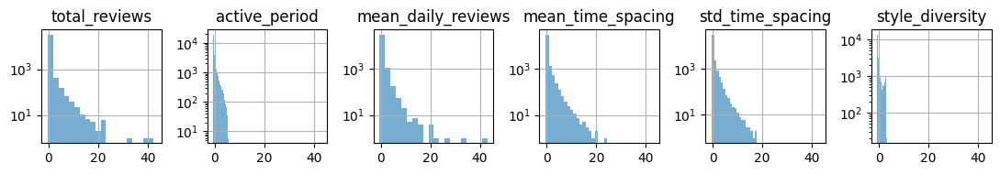

In [23]:
rb_df_features = rb_features
rb_df_features_scaled = pd.DataFrame(StandardScaler().fit(rb_df_features).transform(rb_df_features), columns= rb_df_features.columns)
columns = rb_df_features_scaled.columns

fig, axs = plt.subplots(1, len(columns), figsize=(11, 2), sharex=True)

for column_idx in range(0, len(columns)):
    rb_df_features_scaled[columns[column_idx]].hist(bins=20, ax=axs[column_idx], alpha=0.6)
    axs[column_idx].set_title(columns[column_idx])
    axs[column_idx].set_yscale('log') 
    
plt.tight_layout()

### Number of clusters (silhouette score + elbow method)

Implementation with k=2 done
Implementation with k=3 done
Implementation with k=4 done
Implementation with k=5 done
Implementation with k=6 done
Implementation with k=7 done
Implementation with k=8 done
Implementation with k=9 done
Implementation with k=10 done


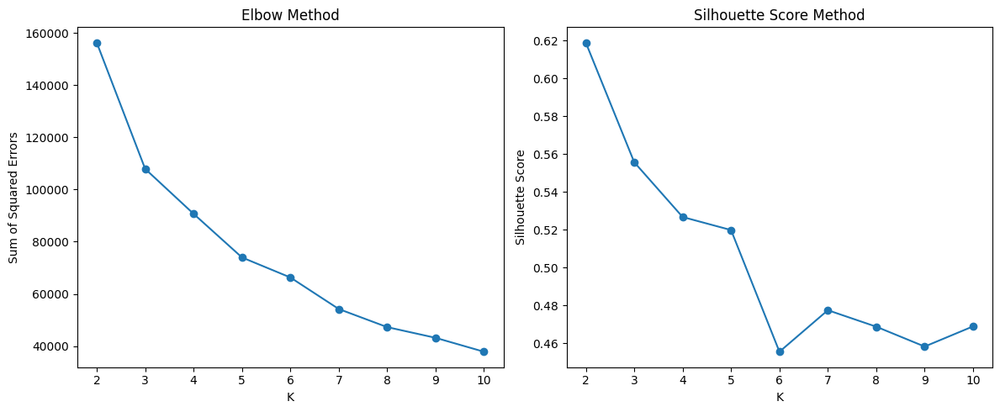

In [24]:
plot_clustering_metrics(rb_df_features_scaled)

**Analyze:** find the number of clusters

### Predicting

In [25]:
rb_number_clusters = 3 #to determine

rb_kmeans = KMeans(n_clusters= rb_number_clusters, random_state= 0)
rb_labels = rb_kmeans.fit_predict(rb_df_features_scaled)
rb_clusterised = pd.DataFrame(pd.Series(rb_labels, index= rb_df_features.index, name= 'cluster')).reset_index()

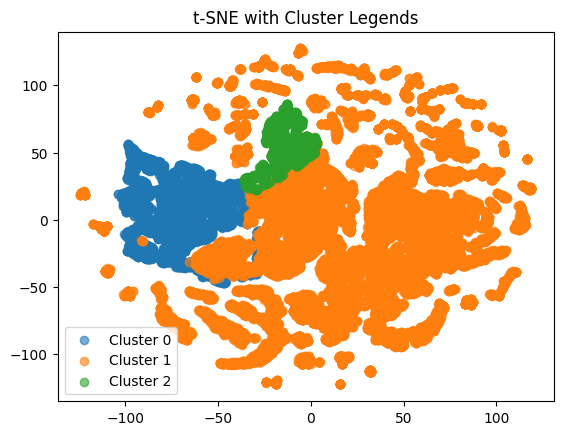

In [26]:
# perform t-SNE dimensionality reduction
rb_df_scaled_features_reduced_tsne = TSNE(n_components= 2, init= 'random', learning_rate= 'auto', random_state= 0).fit_transform(rb_df_features_scaled)
for cluster in range(rb_number_clusters):
    cluster_points = rb_df_scaled_features_reduced_tsne[rb_labels == cluster]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=f'Cluster {cluster}', alpha=0.6)
plt.title("t-SNE with Cluster Legends")
plt.legend()
plt.show()

In [27]:
rb_clusterised_feat = rb_clusterised.join(rb_features, on='user_id', how='left')

In [28]:
fig = px.scatter(rb_clusterised_feat, x='active_period', y='total_reviews', color='cluster')
fig.show()

fig = px.scatter(rb_clusterised_feat, x='total_reviews', y='mean_time_spacing', color='cluster')
fig.show()

fig = px.scatter(rb_clusterised_feat, x='mean_daily_reviews', y='mean_time_spacing', color='cluster')
fig.show()

fig = px.scatter(rb_clusterised_feat[rb_clusterised_feat['cluster']==0], x='mean_daily_reviews', y='mean_time_spacing', color='cluster')
fig.show()

fig = px.scatter(rb_clusterised_feat, x='mean_daily_reviews', y='style_diversity', color='cluster')
fig.show()

fig = px.scatter(rb_clusterised_feat, x='mean_time_spacing', y='std_time_spacing', color='cluster')
fig.show()

In [29]:
rb_cluster_summary = rb_clusterised_feat.drop(columns='user_id').groupby('cluster').agg(['mean','median','std','min','max'])
rb_cluster_summary

total_reviews                                active_period          \
                 mean median          std min    max          mean  median   
cluster                                                                      
0         1249.009682  509.5  2300.396463  22  43251   2375.842758  2111.0   
1           23.439825    8.0    42.037666   3    623    259.199816    71.0   
2            7.173740    5.0     5.997372   3     44   1631.327586  1372.5   

                                 ... std_time_spacing                          \
                 std  min   max  ...             mean      median         std   
cluster                          ...                                            
0        1278.052697   61  6294  ...        34.262414   12.428548   55.666257   
1         395.350829    1  2989  ...        38.062475   10.396120   60.412680   
2         965.077018  414  5662  ...       550.311304  458.798661  321.964390   

                                style_diversity                            
               min          max            mean median        std min max  
cluster                                                                    
0         0.303450   485.207509       61.885747   65.0  15.419391   9  90  
1         0.000000   392.657757       10.395839    6.0  10.683521   1  73  
2        10.606602  2567.504722        5.448276    4.0   3.662881   1  24  

[3 rows x 30 columns]

In [30]:
cluster_mean = rb_clusterised_feat.drop(columns='user_id').groupby('cluster').mean()
experienced_cluster = cluster_mean['total_reviews'].idxmax()
rb_label_experts = experienced_cluster 

rb_experts = rb_clusterised_feat[rb_clusterised_feat['cluster'] == rb_label_experts]['user_id']
rb_experts.to_csv('../generated/rb_experts.csv', index=False)

## Comparison with simple thresholds
For the same features, we want to define the criteria for a user to be considered as experienced.
- total reviews >= 50
- mean spacing time < 7 jours (equivalent to mean monthly reviews >= 4 -> mean daily reviews >= 0.13)
- style diversity >= 15

In [31]:

ba_threshold_feat = ba_features.copy()
ba_threshold_feat = ba_threshold_feat[ba_threshold_feat['total_reviews'] >= 100]
ba_threshold_feat = ba_threshold_feat[ba_threshold_feat['mean_time_spacing'] < 7]
ba_threshold_feat = ba_threshold_feat[ba_threshold_feat['style_diversity'] >= 15]

rb_threshold_feat = rb_features.copy()
rb_threshold_feat = rb_threshold_feat[rb_threshold_feat['total_reviews'] >= 100]
rb_threshold_feat = rb_threshold_feat[rb_threshold_feat['mean_time_spacing'] < 7]
rb_threshold_feat = rb_threshold_feat[rb_threshold_feat['style_diversity'] >= 15]

In [32]:
ba_threshold_feat

,total_reviews,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity
user_id,,,,,,
-rick.912339,197,915,0.215301,4.653061,12.024848,34
1000lbgrizzly.741995,699,1472,0.474864,2.101719,2.751230,92
11-52_4hops.1077281,152,537,0.283054,3.543046,3.974477,34
2xhops.491130,112,765,0.146405,6.864865,20.323066,43
303beer.964947,192,399,0.481203,2.078534,4.971403,51
...,...,...,...,...,...,...
zoso1967.252721,541,2052,0.263645,3.792593,37.391941,81
zoso493.251204,203,847,0.239669,4.178218,14.772838,60
zrab11.543838,255,363,0.702479,1.421260,8.079625,60


In [33]:
rb_threshold_feat

,total_reviews,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity
user_id,,,,,,
100055,665,2736,0.243056,4.108434,6.417382,71
1001,6172,5865,1.052344,0.947658,2.960247,80
10022,1535,1841,0.833786,1.196219,11.559200,68
100269,8148,2577,3.161816,0.315331,1.056524,79
10035,673,1396,0.482092,2.069940,4.126847,65
...,...,...,...,...,...,...
99747,924,2753,0.335634,2.973998,9.225976,67
99781,1385,2735,0.506399,1.970376,3.431152,80
9984,120,356,0.337079,2.974790,19.632411,29


In [34]:
ba_cluster_feat = pd.DataFrame(ba_experts)
ba_cluster_feat

,user_id
0,--dom--.709199
3,-mk-.763762
4,-rick.912339
5,-steve-.781156
6,007.8521
...,...
30674,zymrgy.233567
30676,zymurgo.447590
30677,zymurgy4all.11427
30678,zythophile.1101219


In [35]:
rb_cluster_feat = pd.DataFrame(rb_experts)
rb_cluster_feat

,user_id
1,100007
5,100029
7,100055
11,1001
22,10022
...,...
32736,99747
32742,99781
32759,99890
32760,999


In [36]:
ba_common_users = pd.merge(ba_threshold_feat, ba_cluster_feat, on='user_id', how='inner')
ba_common_users

,user_id,total_reviews,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity
0,-rick.912339,197,915,0.215301,4.653061,12.024848,34
1,1000lbgrizzly.741995,699,1472,0.474864,2.101719,2.751230,92
2,11-52_4hops.1077281,152,537,0.283054,3.543046,3.974477,34
3,2xhops.491130,112,765,0.146405,6.864865,20.323066,43
4,303beer.964947,192,399,0.481203,2.078534,4.971403,51
...,...,...,...,...,...,...,...
2896,zoso1967.252721,541,2052,0.263645,3.792593,37.391941,81
2897,zoso493.251204,203,847,0.239669,4.178218,14.772838,60
2898,zrab11.543838,255,363,0.702479,1.421260,8.079625,60
2899,zshaft.1101155,254,548,0.463504,2.158103,5.549802,42


In [37]:
rb_common_users = pd.merge(rb_threshold_feat, rb_cluster_feat, on='user_id', how='inner')
rb_common_users

,user_id,total_reviews,active_period,mean_daily_reviews,mean_time_spacing,std_time_spacing,style_diversity
0,100055,665,2736,0.243056,4.108434,6.417382,71
1,1001,6172,5865,1.052344,0.947658,2.960247,80
2,10022,1535,1841,0.833786,1.196219,11.559200,68
3,100269,8148,2577,3.161816,0.315331,1.056524,79
4,10035,673,1396,0.482092,2.069940,4.126847,65
...,...,...,...,...,...,...,...
3666,99672,284,173,1.641618,0.607774,0.890181,64
3667,99740,1821,2751,0.661941,1.507143,2.830847,75
3668,99747,924,2753,0.335634,2.973998,9.225976,67
3669,99781,1385,2735,0.506399,1.970376,3.431152,80
